In [3]:
import pandas as pd
import numpy as np
import pickle
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer, ENGLISH_STOP_WORDS
from tqdm import tqdm
from nltk import word_tokenize, FreqDist
import matplotlib.pyplot as plt

In [8]:
with open("newest_main_df.pickle", "rb") as to_read:
     main_df = pickle.load(to_read)

## Adding "Review length" as a column

In [6]:
def review_length(review):

    review_length = len(review.split())

    return review_length

In [5]:
main_df["Review length"] = main_df["Full review"].apply(lambda x: review_length(x))

In [5]:
main_df.groupby("Month of stay")["Vader +"].mean()

Month of stay
1.0     0.333032
2.0     0.329967
3.0     0.326659
4.0     0.333819
5.0     0.314747
6.0     0.307647
7.0     0.306632
8.0     0.304542
9.0     0.312721
10.0    0.333707
11.0    0.332612
12.0    0.332488
Name: Vader +, dtype: float64

In [6]:
main_df.groupby("Month of stay")["Vader -"].mean()

Month of stay
1.0     0.043122
2.0     0.040432
3.0     0.041645
4.0     0.041874
5.0     0.040397
6.0     0.042529
7.0     0.042481
8.0     0.043819
9.0     0.041674
10.0    0.041539
11.0    0.042252
12.0    0.040735
Name: Vader -, dtype: float64

In [7]:
main_df.groupby("Month of stay")["Review length"].mean()

Month of stay
1.0     84.976849
2.0     88.673945
3.0     88.682866
4.0     82.867392
5.0     91.400558
6.0     94.454874
7.0     96.116900
8.0     95.268904
9.0     93.620354
10.0    85.145041
11.0    82.048860
12.0    82.713909
Name: Review length, dtype: float64

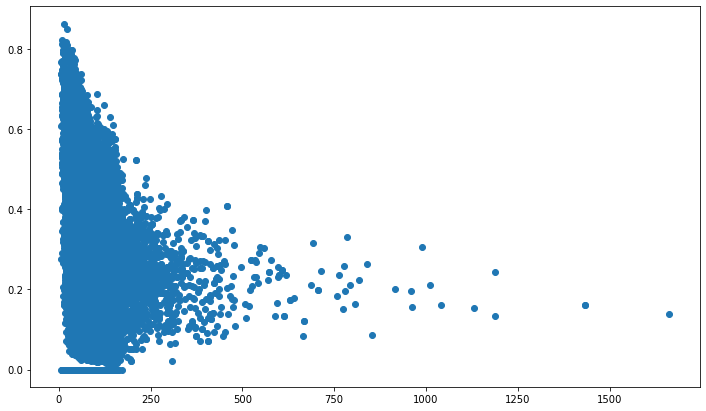

In [7]:
pos = main_df["Vader +"]
length = main_df["Review length"]
plt.figure(figsize=(12, 7))
plt.scatter(length, pos);

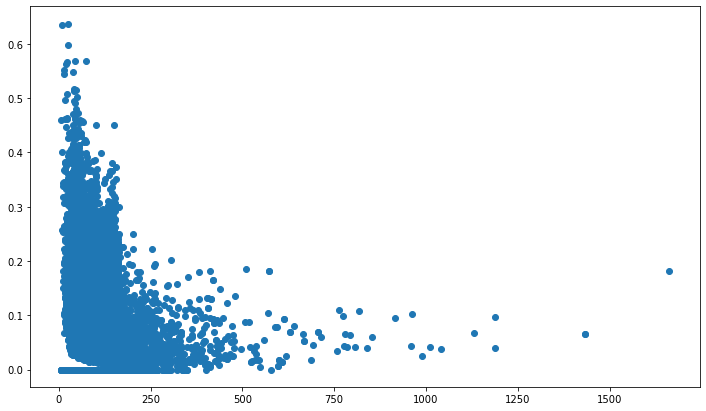

In [8]:
neg = main_df["Vader -"]
length = main_df["Review length"]
plt.figure(figsize=(12, 7))
plt.scatter(length, neg);

In [ ]:
import spacy
import scattertext as st

nlp = spacy.load("en_core_web_sm")
corpus = st.CorpusFromPandas(main_df,
                             category_col='Vader +',
                             text_col='Cleaned review v2',
                             nlp=nlp).build()

In [9]:
corpus = main_df['Cleaned review v2']
tfidf = TfidfVectorizer(stop_words="english", max_df=.5, min_df=5, ngram_range=(1, 3), binary=True, sublinear_tf=False)
df_vectorized = tfidf.fit_transform(corpus)
vocab = tfidf.get_feature_names()

In [10]:


corex = ct.Corex(n_hidden=2, seed=10)
corex = corex.fit(df_vectorized, docs=corpus.values, words=vocab, anchors=[["hotel"], ["breakfast"], ["cruise"], ["staff"]])
model_list.append(corex)
tcs_list.append(corex.tcs)
p_y_list.append(corex.p_y_given_x)
tc_history_list.append(corex.tc_history)
topics = []
top_docs_list.append(corex.get_top_docs())
for i, topic_ngrams in enumerate(corex.get_topics(n_words=10)):
    topic_ngrams = [ngram[0] for ngram in topic_ngrams if ngram[1] > 0]
    topics.append("Topic #{}: {}".format(i+1, ", ".join(topic_ngrams)))
topics_list.append(topics)

In [4]:
with open("newest_main_df.pickle", "wb") as to_write:
     pickle.dump(main_df, to_write)

NameError: name 'main_df' is not defined

In [14]:
hotels_by_review_count = main_df.groupby("Property name")["Full review"].count().reset_index().sort_values(by="Full review", ascending=False)

In [17]:
hotels_by_review_count[hotels_by_review_count["Full review"] < 5]

,Property name,Full review
100,Alaska Log Cabins on the Pond B&B,4
1359,Whispering Winds Retreat B&B,4
1385,Yentna Station Roadhouse,4
383,Capt'n Lou's Ptarmigan Lodge,4
1125,Silver Fox Roadhouse,4
...,...,...
1032,RV Sites in Homer,1
300,Bella Haven Estates,1
70,Alaska Cozy II Suites,1
150,Alaskan Lodge & Retreat,1


In [37]:
hotels_5_reviews = hotels_by_review_count[hotels_by_review_count["Full review"] >= 5]

In [29]:
hotels_by_word_count = main_df.groupby("Property name")["Review length"].sum().reset_index().sort_values(by="Review length", ascending=False)

In [35]:
hotels_by_word_count[hotels_by_word_count["Review length"] < 500]

,Property name,Review length
173,AllSeasons Bed & Breakfast,498
1272,The Silver Derby Campground & RV Park,498
713,Hillside Cabins,497
5,6 Mile Bed and Breakfast,496
280,Bear Country Lodge,495
...,...,...
1299,Top of the Rock Lodge,36
350,Borealis Stay,35
61,Alaska Bed and Breakfast Rentals,35
613,Frog Pond Bed and Breakfast,34


In [36]:
hotels_500_words = hotels_by_word_count[hotels_by_word_count["Review length"] >= 500]

# Adding nouns-only feature

In [45]:
!pip install -U spacy
!pip install spacy[lookups]
import spacy
!python -m spacy download en_core_web_sm
nlp = spacy.load("en_core_web_sm")

def get_nouns(review):

    review = nlp(review)
    review_nouns = []
    for token in review:
        if token.lemma_ != "ovid" and (token.pos_ == "NOUN" or token.pos_ == "PROPN"):
            review_nouns.append(token.lemma_)

    return " ".join(review_nouns)

Requirement already up-to-date: spacy in /opt/anaconda3/lib/python3.8/site-packages (2.3.2)
✔ Download and installation successful
You can now load the model via spacy.load('en_core_web_sm')


OSError: [E050] Can't find model 'en_core_web_sm'. It doesn't seem to be a shortcut link, a Python package or a valid path to a data directory.

In [7]:
main_df

,Property name,Property address,"Lat, long",Reviewer,Review date,Date of stay,Review title,Full review,Review link,Spell-checked review,Cleaned review,Month of stay,Year of stay,Vader +,Vader -,Cleaned review v2,Review length,Review nouns,Review adjs
0,Harbor 360 Hotel,"1412 4th Ave., Seward, AK 99664","60.119797,-149.439346",John M,October 2020,October 2020,Awesome hotel doing all the right things,I stay at lots of hotels (including during Cov...,https://www.tripadvisor.com/ShowUserReviews-g6...,I stay at lots of hotels including during ovid...,stay lot hotel include ovid harbour right grea...,10.0,2020.0,0.250,0.000,stay lot hotel include ovid harbour right grea...,97,lot hotel harbour hotel price excellent locati...,right great fair friendly clean reasonable
1,Harbor 360 Hotel,"1412 4th Ave., Seward, AK 99664","60.119797,-149.439346",Kenai Drift Anglers,October 2020,October 2020,Great Local Get Away,My girlfriend just wanted to get away from tow...,https://www.tripadvisor.com/ShowUserReviews-g6...,My girlfriend just wanted to get away from tow...,girlfriend want get away town enjoy great even...,10.0,2020.0,0.480,0.049,girlfriend want away town enjoy great evening ...,52,girlfriend town evening restriction hotel brea...,great covid great
2,Harbor 360 Hotel,"1412 4th Ave., Seward, AK 99664","60.119797,-149.439346",TravelGirl2006,October 2020,October 2020,We love this hotel,Have stayed here twice on our last two trips t...,https://www.tripadvisor.com/ShowUserReviews-g6...,Have stayed here twice on our last two trips t...,stay twice last two trip seward view marina fa...,10.0,2020.0,0.480,0.000,stay twice trip seward view marina fantastic r...,100,trip seward view marina room spotless bathroom...,fantastic large good adapt covid friendly grea...
3,Harbor 360 Hotel,"1412 4th Ave., Seward, AK 99664","60.119797,-149.439346",maduro44,October 2020,September 2020,Bed,Everything was really nice almost great if it ...,https://www.tripadvisor.com/ShowUserReviews-g6...,Everything was really nice almost great if it ...,everything really nice almost great haunt bed ...,9.0,2020.0,0.440,0.158,really nice great haunt bed bed horrible mattr...,54,haunt bed bed horrible mattress help year bed,nice great
4,Harbor 360 Hotel,"1412 4th Ave., Seward, AK 99664","60.119797,-149.439346",rtfields2020,October 2020,September 2020,Great place,"Terrific place to stay. Comfortable and clean,...",https://www.tripadvisor.com/ShowUserReviews-g6...,Terrific place to stay. Comfortable and clean ...,terrific place clean friendly staff excellent ...,9.0,2020.0,0.401,0.000,terrific place clean friendly staff excellent ...,45,place staff breakfast sit balcony mountain har...,terrific clean friendly excellent incredible r...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
111306,Anchorage Suite Lodge,"441 E 15th Ave, Anchorage, AK 99501-5211","61.207958,-149.875854",BigBubbaSpokane,August 2007,August 2007,Horror in Anchorage,"This is the most disgusting, filthy, unsanitar...",https://www.tripadvisor.com/ShowUserReviews-g6...,This is the most disgusting filthy unsanitary ...,disgust filthy unsanitary rundown hole ever en...,8.0,2007.0,0.047,0.391,disgust filthy unsanitary rundown hole encount...,77,disgust filthy rundown hole encounter daughter...,unsanitary late gross terrible bad
111307,Anchorage Suite Lodge,"441 E 15th Ave, Anchorage, AK 99501-5211","61.207958,-149.875854",Angeles,July 2007,July 2007,Do not stay here,This hotel was booked for us as part of a grou...,https://www.tripadvisor.com/ShowUserReviews-g6...,This hotel was booked for us as part of a grou...,hotel book us part group three couple suppose ...,7.0,2007.0,0.000,0.138,hotel book group couple suppose stay night cou...,153,hotel book group couple stay night couple plac...,awful second denali old large denali
111308,Anchorage Suite Lodge,"441 E 15th Ave, Anchorage, AK 99501-5211","61.207958,-149.875854",754Lynn,July 2005,July 2005,Misleading-- Don't fall for this dump